<hr>
<p style="font-size:40px;text-align:center">Take Home - Data Science</p>
<hr>

# The Hotel Bookings Data
Let’s use hotel bookings data from [Antonio, Almeida, and Nunes (2019)](https://www.sciencedirect.com/science/article/pii/S2352340918315191?via%3Dihub) to predict which hotel stays included children and/or babies, based on the other characteristics of the stays such as which hotel the guests stay at, how much they pay, etc.

<img src="https://s3-us-west-2.amazonaws.com/fligoo.data-science/TechInterviews/HotelBookings/header.png"/>

One of the hotels (H1) is a resort hotel and the other is a city hotel (H2). Both datasets share the same structure, with 23 variables describing the 19248 observations of H1 and 30752 observations of H2. Each observation represents a hotel booking. Both datasets comprehend bookings due to arrive between the 1st of July of 2015 and the 31st of August 2017, including bookings that effectively arrived and bookings that were canceled. Since this is hotel real data, all data elements pertaining hotel or custumer identification were deleted.

**Take-Home Goals**

#### Part 1
During **Part I**, you should perform an Exploratory Data Analysis highlighting key findings:
  - Data Quality Check: You must check the quality of the given dataset to make an assessment of how appropriate it is for later Data Science tasks. Propose a set of corrective actions over the data if any.
  - Report insights and conclusions: Describe the results obtained during the exploratory analysis and provide conclusions from a business perspective, supported by plots / tables / metrics.
  - **Expected**:
    - Make at least 10 plots with any ploting library (plotly, matplotlib, seaborn, etc.)
    - Write down the conclusions, in a clear manner, of every plot in this notebook

#### Part 2
In **Part II** you should define and train a model to predict which actual hotel stays included children/babies, and which did not:
  - **Feature extraction:** Indicate some possible candidates of features that could properly describe the hotels, either from the given columns or from their transformations.
      - **Expected**:
        - Create **one** scikit-learn pipeline inside a file called `pipelines.py`
        - Create at least **three** scikit-learn transformers inside a file called `transformers.py` and use them inside the pipeline from previous step. This transformers should add new features or clean the original dataframe of this take-home
          - Feature example: Compute "total_nights" feature. This is the sum of `stays_in_week_nights` + `stays_in_weekend_nights`
          - Cleaning example: Transform string values. `'0'` to int type `0` 
        - Import pipeline and run the transformations inside this notebook

  - **Machine Learning modeling:** Fit models with the given data. Pay attention to the entire process to avoid missing any crucial step. You could use the `children` column as target.
    - **Expected**:
      - Use the dataset with the new features generated to train *at least* **three** different machine learning models and generate metrics about their performance.
    
#### Part 3
Finally, on **Part III** you should present the key findings, conclusions and results to non-technical stakeholders.
  - **Expected**:
    - Create a summary of all the findings in part 1
    - Create an explanation of the features added in part 2
    - Create a summary of the model metrics
    - These explanations should be at high level and understood by a non-technical person
    - You can add all the summaries and explanations at the end of this notebook, it can be done in markdown format or any other external resource like a ppt presentation, pdf document, etc. Whatever works best for you!

 
**Requirements**
- Python 3.x & Pandas 1.x
- Paying attention to the details and narrative is far way more important than extensive development.
- Once you complete the assessment, please send a ZIP file of the folder with all the resources used in this work (e.g. Jupyter notebook, Python scripts, text files, images, etc) or share the repository link.
- Virtualenv, requirements or Conda environment for isolation.
- Have a final meeting with the team to discuss the work done in this notebook and answer the questions that could arise.
- Finally, but most important: Have fun!

**Nice to have aspects**
- Code versioning with Git (you are free to publish it on your own Github/Bitbucket account!).
- Show proficiency in Python: By showing good practices in the structure and documentation, usage of several programming paradigms (e.g. imperative, OOP, functional), etc.
- Shap Model explanability: explain feature importance with the use of shapley values

## Part I - Exploratory Data Analisys

In [41]:
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go

import plotly_utils

pd.set_option('display.max_columns', 500)

In [ ]:
#hotels = pd.read_csv('https://s3-us-west-2.amazonaws.com/fligoo.data-science/TechInterviews/HotelBookings/hotels.csv')
#hotels.shape

(50000, 23)

In [42]:
hotels = pd.read_csv('data/hotels.csv')

In [43]:
hotels.head()

,hotel,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,average_daily_rate,required_car_parking_spaces,total_of_special_requests,arrival_date
0,City_Hotel,217,1,3,2,none,BB,DEU,Offline_TA/TO,TA/TO,0,0,0,A,A,0,No_Deposit,0,Transient-Party,80.75,none,1,2016-09-01
1,City_Hotel,2,0,1,2,none,BB,PRT,Direct,Direct,0,0,0,D,K,0,No_Deposit,0,Transient,170.00,none,3,2017-08-25
2,Resort_Hotel,95,2,5,2,none,BB,GBR,Online_TA,TA/TO,0,0,0,A,A,2,No_Deposit,0,Transient,8.00,none,2,2016-11-19
3,Resort_Hotel,143,2,6,2,none,HB,ROU,Online_TA,TA/TO,0,0,0,A,A,0,No_Deposit,0,Transient,81.00,none,1,2016-04-26
4,Resort_Hotel,136,1,4,2,none,HB,PRT,Direct,Direct,0,0,0,F,F,0,No_Deposit,0,Transient,157.60,none,4,2016-12-28


### 1.0 Quality Check

In [ ]:
##initial info
hotels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 43385 entries, 0 to 43384
Data columns (total 23 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   hotel                           43385 non-null  object 
 1   lead_time                       43385 non-null  int64  
 2   stays_in_weekend_nights         43385 non-null  int64  
 3   stays_in_week_nights            43385 non-null  int64  
 4   adults                          43385 non-null  int64  
 5   children                        43385 non-null  object 
 6   meal                            43385 non-null  object 
 7   country                         43098 non-null  object 
 8   market_segment                  43385 non-null  object 
 9   distribution_channel            43385 non-null  object 
 10  is_repeated_guest               43385 non-null  int64  
 11  previous_cancellations          43385 non-null  int64  
 12  previous_bookings_not_canceled  

#### 1.01 Null Values

- Check about null Values

In [57]:
hotels.isna().mean()

hotel                             0.000000
lead_time                         0.000000
stays_in_weekend_nights           0.000000
stays_in_week_nights              0.000000
adults                            0.000000
children                          0.000000
meal                              0.000000
country                           0.006615
market_segment                    0.000000
distribution_channel              0.000000
is_repeated_guest                 0.000000
previous_cancellations            0.000000
previous_bookings_not_canceled    0.000000
reserved_room_type                0.000000
assigned_room_type                0.000000
booking_changes                   0.000000
deposit_type                      0.000000
days_in_waiting_list              0.000000
customer_type                     0.000000
average_daily_rate                0.000000
required_car_parking_spaces       0.000000
total_of_special_requests         0.000000
arrival_date                      0.000000
dtype: floa

 **About null values**

 - The PMS assured no missing data exists in its database tables. However, in some categorical variables like Agent or Company, “NULL” is presented as one of the categories. This should not be considered a missing value, but rather as “not applicable”. For example, if a booking “Agent” is defined as “NULL” it means that the booking did not came from a travel agent.


- As it comes from country, you have a few Null values (289) 

#### 1.02 Duplicated Values

Explore duplicated records on dataset

In [44]:
hotels.duplicated().sum()

6615

In [ ]:
#some examples of duplicated rows
hotels[hotels.duplicated()].head()

,hotel,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,country,market_segment,distribution_channel,is_repeated_guest,previous_cancellations,previous_bookings_not_canceled,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,average_daily_rate,required_car_parking_spaces,total_of_special_requests,arrival_date
44,City_Hotel,134,0,1,1,none,BB,PRT,Groups,TA/TO,0,0,0,A,A,0,No_Deposit,0,Transient-Party,75.00,none,0,2017-02-25
237,City_Hotel,504,2,1,2,none,BB,GBR,Offline_TA/TO,TA/TO,0,0,0,A,A,0,No_Deposit,0,Transient-Party,112.67,none,1,2017-08-12
288,City_Hotel,256,0,2,2,none,HB,DEU,Offline_TA/TO,TA/TO,0,0,0,A,A,0,No_Deposit,0,Transient-Party,115.00,none,1,2016-06-15
330,City_Hotel,263,2,2,2,none,BB,PRT,Groups,TA/TO,0,0,0,A,A,0,No_Deposit,0,Transient-Party,105.00,none,1,2017-06-23
356,City_Hotel,457,0,2,2,none,HB,DEU,Offline_TA/TO,TA/TO,0,0,0,A,A,1,No_Deposit,0,Transient-Party,122.40,none,1,2017-08-25


In [52]:
hotels[hotels.duplicated()]['customer_type'].value_counts(normalize=True)

customer_type
Transient-Party    0.776266
Transient          0.208919
Contract           0.013152
Group              0.001663
Name: proportion, dtype: float64

**Handling Duplicate Records**

The dataset contains duplicate records where all column values are identical. While the simplest approach is to drop these duplicates to streamline the modeling process, a more thorough analysis would involve investigating the root cause of these duplications. Below are some potential hypotheses:

- Agency Packages: Agencies might be selling packages to a large number of customers for specific events or vacations, leading to identical bookings.
- Group Bookings: Certain groups or organizations may be making bookings on behalf of multiple individuals, resulting in duplicate entries.

TODO: By understanding the source of these duplicates, you construct new features that maybe i'll help the model

In [58]:
# Drop duplicates
hotels = hotels.drop_duplicates().reset_index(drop=True)

#### 1.03 Target initial definition

In [ ]:
### Target variable checking
hotels['children'].value_counts(normalize=True)

children
none        0.90749
children    0.09251
Name: proportion, dtype: float64

In [64]:
hotels["has_children"] = (hotels['children'].str.lower() != "none")

### 1.1 Temporal Analysis

The goal of this section is to explore temporal patterns in the data and identify any seasonality that may impact the analysis. Key points to investigate include:

- Total Bookings by Hotel Type: Analyze how the number of bookings varies over time for different hotel types.
- Child Presence by Hotel Type: Examine the presence or absence of children across different hotel types over time.
- Trends and Target Comparison: Identify distinct trends and compare them with the target variable to ensure alignment with the problem definition.

In [7]:
hotels['hotel'].value_counts(normalize=True)

hotel
City_Hotel      0.61504
Resort_Hotel    0.38496
Name: proportion, dtype: float64

In [ ]:
plotly_utils.create_time_line_plot(
    data = hotels,
    x = 'arrival_date',
    group_column = 'hotel',
    y= 'adults',
    agg_func = 'count',
    freq = 'W',
    title='Weekly Total Bookings Over Time by Hotel Type',
    y_label='Bookings',
    x_label='Arrival Date'
)

/home/yan-cunha/anaconda3/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning: The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result
  v = v.dt.to_pydatetime()


In [ ]:
plotly_utils.create_time_line_plot(
    data = hotels,
    x = 'arrival_date',
    group_column = 'hotel',
    y = 'has_children',
    agg_func = 'sum',
    freq = 'W',
    title = 'Weekly Total Bookings with Children Over Time by Hotel Type',
    y_label = 'Children Presence',
    x_label = 'Arrival Date'
)

/home/yan-cunha/anaconda3/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [ ]:
plotly_utils.create_children_rate_plot(
    data=hotels,
    date_column='arrival_date',
    group_column='hotel',
    children_column='has_children',
    freq='W',
    title='Weekly Children Rate Over Time by Hotel Type',
    y_label='Children Rate',
    x_label='Arrival Date'
)

/home/yan-cunha/anaconda3/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [ ]:
plotly_utils.create_time_line_plot(
    data = hotels,
    x = 'arrival_date',
    group_column = 'hotel',
    y = 'stays_in_week_nights',
    agg_func = 'mean',
    freq = 'W',
    title = 'Average Week Stays Bookings Over Time by Hotel Type',
    y_label = 'Average Week Stays',
    x_label = 'Arrival Date'
)

/home/yan-cunha/anaconda3/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [ ]:
plotly_utils.create_time_line_plot(
    data = hotels,
    x = 'arrival_date',
    group_column = 'hotel',
    y = 'average_daily_rate',
    agg_func = 'mean',
    freq = 'W',
    title = 'Weekly Avg Daily Rate Over Time by Hotel Type',
    y_label = 'Average Week Stays',
    x_label = 'Arrival Date'
)

/home/yan-cunha/anaconda3/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [ ]:
plotly_utils.create_time_line_plot(
    data = hotels,
    x = 'arrival_date',
    group_column = 'hotel',
    y = 'average_daily_rate',
    agg_func = 'sum',
    freq = 'W',
    title = 'Weekly Total Daily Rate Over Time by Hotel Type',
    y_label = 'Average Week Stays',
    x_label = 'Arrival Date'
)

/home/yan-cunha/anaconda3/lib/python3.9/site-packages/_plotly_utils/basevalidators.py:106: FutureWarning:

The behavior of DatetimeProperties.to_pydatetime is deprecated, in a future version this will return a Series containing python datetime objects instead of an ndarray. To retain the old behavior, call `np.array` on the result



In [196]:
hotels.groupby('hotel')['average_daily_rate'].agg(['mean', 'sum']).reset_index().sort_values('mean', ascending=False)

,hotel,mean,sum
0,City_Hotel,105.798933,3253528.78
1,Resort_Hotel,90.585429,1743588.34


In [199]:
hotels.groupby('hotel')['total_nights'].agg(['mean', 'sum']).reset_index().sort_values('mean', ascending=False)

,hotel,mean,sum
1,Resort_Hotel,4.153990,79956
0,City_Hotel,2.916786,89697


In [ ]:

fig = px.box(
    hotels,
    x='hotel',
    y='average_daily_rate',
    labels={'average_daily_rate': 'Average Daily Rate', 'hotel': 'Hotel Type'},
)

fig.show()

**First Conclusions** 

**1. Seasonality and Vacation Patterns**
Both City Hotels and Resort Hotels exhibit clear seasonal trends, with noticeable peaks during vacation periods. These peaks align with times when families are more likely to travel, such as summer holidays and year-end breaks.
The presence of children in bookings also increases during these vacation periods, indicating that family travel is a significant driver of demand during these times.

*Insight:* Vacation periods could be used as a feature in the model to capture these seasonal effects and improve prediction accuracy.

**2. Weekend Stays**
The data shows an increase in weekend stays for both hotel types, particularly during peak seasons. This suggests that weekends are a preferred time for short leisure trips, especially for families.

*Insight:* Including a feature to identify weekend bookings could help the model better capture patterns in customer behavior.

**3. Average Daily Rate and Revenue Trends** 
The average daily rate (ADR) tends to increase during peak periods, particularly for Resort Hotels. This indicates that hotels capitalize on high demand by raising prices during vacation times.
The total revenue (calculated as ADR × total bookings) also follows a similar trend, with higher revenues during peak seasons.

*Insight:* The model could benefit from features that capture pricing trends and their relationship with demand.

**4. Time Splits for Modeling**
The consistent up-and-down trends observed across multiple years suggest that the data is already well-aligned temporally. There is no need for a time-based split during the modeling phase, as the trends are stable and repeatable across years.

*Insight:* A random split of the data is sufficient for training and testing the model, as the temporal patterns are consistent.

**Key Insights**

Resort Hotels:

- Highly dependent on seasonal demand, with sharp peaks and troughs.
- Likely influenced by business events, tourism seasons, and family vacations.

City Hotels:

- Exhibit more stable demand, with consistent bookings throughout the year.

**Feature Engineering Opportunities:**

- Vacation Periods: Create a feature to capture vacation times (e.g., summer, holidays).
- Weekend Stays: Add a feature to identify weekend bookings.
- Seasonal Pricing: Include features related to ADR and revenue trends during peak periods.


### 1.2 Vacation Period

Define the vacation periods and run some analysis

In [ ]:
# Define vacation periods 
vacation_periods = [
    ('Summer', ('06-01', '08-31')),  # June 1st to August 31st
    ('Winter', ('12-15', '01-15'))  # December 15th to January 15th
]

# Convert arrival_date to datetime
hotels['arrival_date'] = pd.to_datetime(hotels['arrival_date'])

#function to check if a date falls within a vacation period
def is_vacation(date):
    for period_name, (start, end) in vacation_periods:
        start_date = pd.to_datetime(f"{date.year}-{start}")
        # Handle year overlap for winter vacation
        end_date = pd.to_datetime(f"{date.year}-{end}") if start < end else pd.to_datetime(f"{date.year + 1}-{end}")
        if start_date <= date <= end_date:
            return period_name
    return 'Non-Vacation'

# Apply the function to create a new column
hotels['vacation_period'] = hotels['arrival_date'].apply(is_vacation)

# Example output
print(hotels[['arrival_date', 'vacation_period']].head())

  arrival_date vacation_period
0   2016-09-01    Non-Vacation
1   2017-08-25          Summer
2   2016-11-19    Non-Vacation
3   2016-04-26    Non-Vacation
4   2016-12-28          Winter


In [40]:
hotels['vacation_period'].value_counts()

vacation_period
Non-Vacation    33113
Summer          15258
Winter           1629
Name: count, dtype: int64

In [ ]:
hotels['has_vacation'] = hotels['vacation_period'].apply(lambda x: False if x == 'Non-Vacation' else True)
hotels['has_vacation'].value_counts()

has_vacation
False    33113
True     16887
Name: count, dtype: int64

In [ ]:
vacation_analysis = hotels.groupby('has_vacation')['has_children'].mean().reset_index()
vacation_analysis['has_vacation'] = vacation_analysis['has_vacation'].map({False: 'No Vacation', True: 'With Vacation'})

fig = px.bar(
    vacation_analysis,
    x='has_vacation',
    y='has_children',
    title='has_vacation by Presence of Children',
    labels={'has_vacation': 'Vacation Period', 'has_children': 'Presence of Children'},
    color='has_vacation'
)

fig.show()

**Conclusions**

**Vacation Periods and Child Presence:**

- The plot clearly shows that the presence of children in bookings is significantly higher during vacation periods compared to non-vacation periods. This aligns with the expectation that families are more likely to travel during school breaks, such as summer and winter vacations.

**Distribution of Bookings:**
- The majority of bookings occur during non-vacation periods (33,113 bookings), indicating that a large portion of hotel demand is driven by non-seasonal factors, such as business travel or regular leisure trips.
- Summer vacations account for a substantial number of bookings (15,258), highlighting its importance as a peak travel period.
- Winter vacations contribute a smaller but still notable number of bookings (1,629), likely due to holiday travel and winter-specific activities.

**Key Insight:**
The vacation period is a strong indicator of child presence in bookings and should be included as a feature in the model. It captures seasonal family travel behavior and can improve the model's ability to predict child presence.


### 1.3 Average Daily Rate

In [ ]:
adr_analysis = hotels.groupby('has_children')['average_daily_rate'].mean().reset_index()
adr_analysis['has_children'] = adr_analysis['has_children'].map({False: 'No Children', True: 'With Children'})

fig = px.bar(
    adr_analysis,
    x='has_children',
    y='average_daily_rate',
    title='Average Daily Rate by Presence of Children',
    labels={'average_daily_rate': 'Average Daily Rate', 'has_children': 'Presence of Children'},
    color='has_children'
)

fig.show()

In [60]:
# Calculate total nights stayed
hotels['total_nights'] = hotels['stays_in_week_nights'] + hotels['stays_in_weekend_nights']
# Calculate total money spent
hotels['total_money'] = hotels['total_nights'] * hotels['average_daily_rate']

In [66]:
adr_analysis = hotels.groupby('has_children')['total_money'].mean().reset_index()
adr_analysis['has_children'] = adr_analysis['has_children'].map({False: 'No Children', True: 'With Children'})

fig = px.bar(
    adr_analysis,
    x='has_children',
    y='total_money',
    title='Total Rate by Presence of Children',
    labels={'total_money': 'Total Rate', 'has_children': 'Presence of Children'},
    color='has_children'
)

fig.show()

**Conclusions** 

The analysis reveals that bookings with children are associated with significantly higher total revenue and average daily rates (ADR) compared to bookings without children. This suggests that families with children tend to spend more on their stays, possibly due to larger group sizes, longer stays, or additional services required for children.

**Key Insight:** The presence of children is a strong indicator of higher revenue, making it an important feature for predicting booking with children.

### 1.4 Stay duration

In [68]:
hotels[['stays_in_week_nights', 'stays_in_weekend_nights', 'total_nights']].describe()

,stays_in_week_nights,stays_in_weekend_nights,total_nights
count,43385.000000,43385.000000,43385.000000
mean,2.517091,0.964250,3.481341
std,2.004315,1.013571,2.693212
min,0.000000,0.000000,0.000000
25%,1.000000,0.000000,2.000000
50%,2.000000,1.000000,3.000000
75%,3.000000,2.000000,4.000000
max,50.000000,19.000000,69.000000


In [ ]:
# Group by the presence of children and calculate the average total nights
stay_duration_analysis = hotels.groupby('has_children')['total_nights'].mean().reset_index()
stay_duration_analysis['has_children'] = stay_duration_analysis['has_children'].map({False: 'No Children', True: 'With Children'})

# Create a bar plot to compare total nights
fig = px.bar(
    stay_duration_analysis,
    x='has_children',
    y='total_nights',
    title='Average Stay Duration by Presence of Children',
    labels={'total_nights': 'Average Stay Duration (Nights)', 'has_children': 'Presence of Children'},
    color='has_children'
)

fig.show()

In [ ]:
stay_duration_analysis = hotels.groupby('has_children')[['stays_in_week_nights', 'stays_in_weekend_nights']].mean().reset_index()
stay_duration_analysis['has_children'] = stay_duration_analysis['has_children'].map({False: 'No Children', True: 'With Children'})

# Melt the DataFrame to long format for a stacked bar plot
stay_duration_melted = stay_duration_analysis.melt(
    id_vars='has_children',
    value_vars=['stays_in_week_nights', 'stays_in_weekend_nights'],
    var_name='Stay Type',
    value_name='Average Nights'
)

# Map stay types to more descriptive labels
stay_duration_melted['Stay Type'] = stay_duration_melted['Stay Type'].map({
    'stays_in_week_nights': 'Week Nights',
    'stays_in_weekend_nights': 'Weekend Nights'
})

# Create a stacked bar plot
fig = px.bar(
    stay_duration_melted,
    x='has_children',
    y='Average Nights',
    color='Stay Type',
    title='Average Stay Duration (Week vs Weekend) by Presence of Children',
    labels={'has_children': 'Presence of Children', 'Average Nights': 'Average Stay Duration (Nights)'},
    barmode='stack'
)

fig.show()

**Conclusion**

The analysis of average stay duration shows no significant difference between bookings with and without children. Both groups exhibit similar patterns in terms of the number of nights spent during the week and on weekends.

- Week Nights: The average number of week nights is consistent across both groups.
- Weekend Nights: Similarly, the average number of weekend nights remains stable regardless of the presence of children.

**Key Insight:** The presence of children does not appear to influence the length of stay, suggesting that other factors (e.g., hotel type, purpose of travel) may play a more significant role in determining stay duration. This feature may have limited predictive power for distinguishing between bookings with and without children.



### 1.5 Special Requests

In [67]:
hotels['total_of_special_requests'].describe()

count    43385.000000
mean         0.754016
std          0.848370
min          0.000000
25%          0.000000
50%          1.000000
75%          1.000000
max          5.000000
Name: total_of_special_requests, dtype: float64

In [87]:
#A binary column indicating if there are any special requests
hotels['has_special_requests'] = (hotels['total_of_special_requests'] > 0).astype(int)

In [ ]:
# Group by the presence of children and calculate the average number of special requests
special_requests_analysis = hotels.groupby('has_children')['total_of_special_requests'].mean().reset_index()
special_requests_analysis['has_children'] = special_requests_analysis['has_children'].map({False: 'No Children', True: 'With Children'})

#bar plot to compare the average number of special requests
fig = px.bar(
    special_requests_analysis,
    x='has_children',
    y='total_of_special_requests',
    title='Average Number of Special Requests by Presence of Children',
    labels={'total_of_special_requests': 'Average Special Requests', 'has_children': 'Presence of Children'},
    color='has_children'
)

fig.show()

In [70]:
#A binary column indicating if there are any special requests
hotels['has_special_requests'] = (hotels['total_of_special_requests'] > 0).astype(int)

# Group by the presence of children and calculate the proportion of bookings with special requests
special_requests_binary_analysis = hotels.groupby('has_children')['has_special_requests'].mean().reset_index()
special_requests_binary_analysis['has_children'] = special_requests_binary_analysis['has_children'].map({False: 'No Children', True: 'With Children'})

#bar plot to compare the proportion of bookings with special requests
fig = px.bar(
    special_requests_binary_analysis,
    x='has_children',
    y='has_special_requests',
    title='Proportion of Bookings with Special Requests by Presence of Children',
    labels={'has_special_requests': 'Proportion of Special Requests', 'has_children': 'Presence of Children'},
    color='has_children'
)

fig.show()

In [117]:
hotels.groupby('has_special_requests')['has_children'].sum().reset_index()

,has_special_requests,has_children
0,0,1282
1,1,2717


In [120]:
# Calculate average special requests by has_children
special_requests_analysis = hotels.groupby('has_special_requests')['has_children'].sum().reset_index()
special_requests_analysis['has_special_requests'] = special_requests_analysis['has_special_requests'].map({0: 'No Special Request', 1: 'Special Request'})

# Plot special requests
fig = px.bar(
    special_requests_analysis,
    y='has_children',
    x='has_special_requests',
    title='Total Number of Special Requests by Presence of Children',
    labels={'has_children': 'Presence of Children', 'has_special_requests': 'Special requests'},
    color='has_special_requests'
)
fig.show()

In [85]:
fig = px.box(
    hotels,
    x='has_children',
    y='total_of_special_requests',
    title='Total of Special Requests by Presence of Children',
    labels={'has_children': 'Presence of Children', 'total_of_special_requests': 'Total of Special Requests'},
    color='has_children',
    color_discrete_map={True: 'blue', False: 'orange'}
)
fig.update_xaxes(tickvals=[False, True], ticktext=['No Children', 'With Children'])
fig.show()

**Conclusion**

**Higher Average Special Requests for Bookings with Children:**

- Bookings with children have a higher average number of special requests compared to bookings without children. This suggests that families are more likely to request additional services, such as cribs, extra beds, or specific room arrangements.

**Proportion of Bookings with Special Requests:**

- The proportion of bookings with at least one special request is also higher for bookings with children. This reinforces the idea that families tend to have more specific needs during their stay.

**Key Insight:**

- The presence of children is a strong indicator of special requests. This feature could be valuable for predicting child presence.

### 1.6 Room type preference

- Are families with children more likely to be reassigned to specific room types?
- Do certain reserved room types consistently map to specific assigned room types, regardless of the presence of children?
- Are there significant differences in the flow patterns between bookings with and without children?


In [ ]:
# Analyze reserved room type distribution
reserved_room_analysis = hotels.groupby(['has_children', 'reserved_room_type']).size().reset_index(name='count')
reserved_room_analysis['has_children'] = reserved_room_analysis['has_children'].map({False: 'No Children', True: 'With Children'})

# Create a bar plot for reserved room types
fig_reserved = px.bar(
    reserved_room_analysis,
    x='reserved_room_type',
    y='count',
    color='has_children',
    title='Distribution of Reserved Room Types by Presence of Children',
    labels={'reserved_room_type': 'Reserved Room Type', 'count': 'Number of Bookings', 'has_children': 'Presence of Children'},
    barmode='group'
)
fig_reserved.show()


In [ ]:
# Analyze assigned room type distribution
assigned_room_analysis = hotels.groupby(['has_children', 'assigned_room_type']).size().reset_index(name='count')
assigned_room_analysis['has_children'] = assigned_room_analysis['has_children'].map({False: 'No Children', True: 'With Children'})

# Create a bar plot for assigned room types
fig_assigned = px.bar(
    assigned_room_analysis,
    x='assigned_room_type',
    y='count',
    color='has_children',
    title='Distribution of Assigned Room Types by Presence of Children',
    labels={'assigned_room_type': 'Assigned Room Type', 'count': 'Number of Bookings', 'has_children': 'Presence of Children'},
    barmode='group'
)
fig_assigned.show()

In [73]:
# Column to indicate reassignment
hotels['is_reassigned'] = hotels['reserved_room_type'] != hotels['assigned_room_type']
hotels['is_reassigned'].value_counts()

is_reassigned
False    34848
True      8537
Name: count, dtype: int64

In [74]:
# Calculate reassignment rate by lead time bins and has_children
reassignment_rate_children = hotels.groupby(['has_children'])['is_reassigned'].mean().reset_index()

# Map `has_children` to more descriptive labels
reassignment_rate_children['has_children'] = reassignment_rate_children['has_children'].map({False: 'No Children', True: 'With Children'})

reassignment_rate_children

,has_children,is_reassigned
0,No Children,0.196821
1,With Children,0.196299


In [ ]:
# Group by reserved, assigned room types, and has_children to calculate the flow counts
room_flow = hotels.groupby(['reserved_room_type', 'assigned_room_type', 'has_children']).size().reset_index(name='count')
room_flow['has_children'] = room_flow['has_children'].map({False: 'No Children', True: 'With Children'})

# Create a grouped bar chart
fig = px.bar(
    room_flow,
    x='reserved_room_type',
    y='count',
    color='assigned_room_type',
    facet_col='has_children',
    title='Flow of Reserved to Assigned Room Types by Presence of Children',
    labels={
        'reserved_room_type': 'Reserved Room Type',
        'count': 'Number of Bookings',
        'assigned_room_type': 'Assigned Room Type',
        'has_children': 'Presence of Children'
    },
    barmode='group'
)

fig.show()

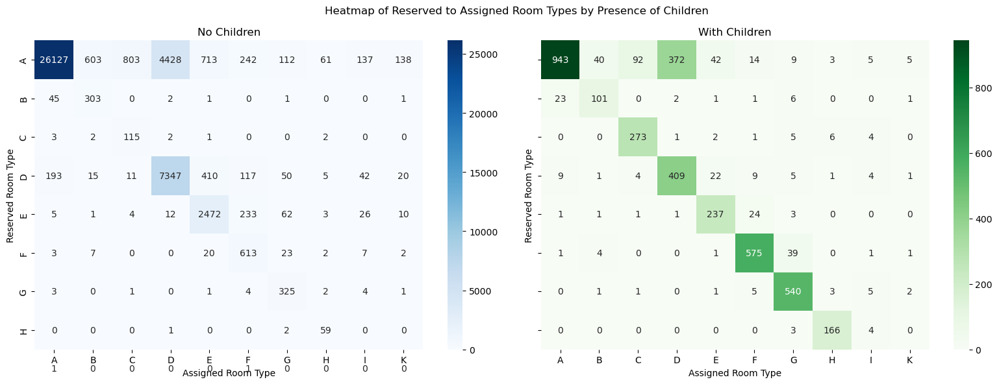

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

# Group by reserved, assigned room types, and has_children to calculate the flow counts
room_flow = hotels.groupby(['reserved_room_type', 'assigned_room_type', 'has_children']).size().reset_index(name='count')

# Separate data for bookings with and without children
room_flow_no_children = room_flow[room_flow['has_children'] == False].pivot(
    index='reserved_room_type', columns='assigned_room_type', values='count'
).fillna(0)

room_flow_with_children = room_flow[room_flow['has_children'] == True].pivot(
    index='reserved_room_type', columns='assigned_room_type', values='count'
).fillna(0)

# Plot heatmaps
fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharey=True)

sns.heatmap(room_flow_no_children, annot=True, fmt=".0f", cmap="Blues", ax=axes[0])
axes[0].set_title('No Children')
axes[0].set_xlabel('Assigned Room Type')
axes[0].set_ylabel('Reserved Room Type')

sns.heatmap(room_flow_with_children, annot=True, fmt=".0f", cmap="Greens", ax=axes[1])
axes[1].set_title('With Children')
axes[1].set_xlabel('Assigned Room Type')
axes[1].set_ylabel('Reserved Room Type')

plt.suptitle('Heatmap of Reserved to Assigned Room Types by Presence of Children')
plt.tight_layout()
plt.show()

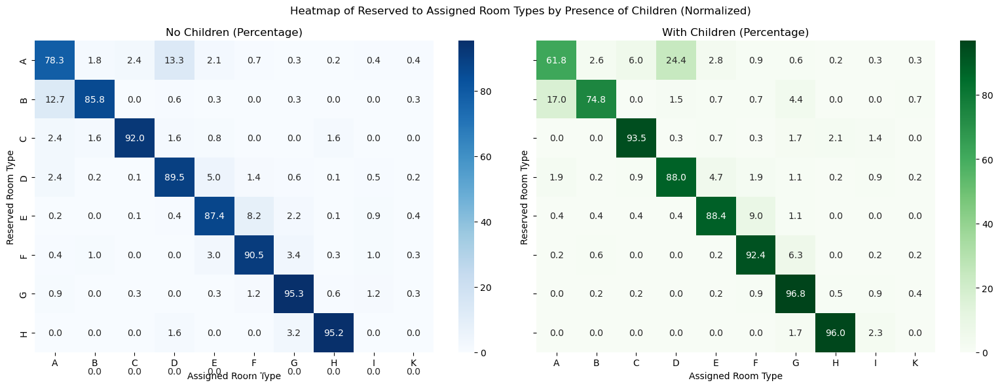

In [ ]:
# Group by reserved, assigned room types, and has_children to calculate the flow counts
room_flow = hotels.groupby(['reserved_room_type', 'assigned_room_type', 'has_children']).size().reset_index(name='count')

# Normalize the counts to percentages within each reserved_room_type and has_children group
room_flow['percentage'] = room_flow.groupby(['reserved_room_type', 'has_children'])['count'].transform(lambda x: x / x.sum() * 100)

# Separate data for bookings with and without children
room_flow_no_children = room_flow[room_flow['has_children'] == False].pivot(
    index='reserved_room_type', columns='assigned_room_type', values='percentage'
).fillna(0)

room_flow_with_children = room_flow[room_flow['has_children'] == True].pivot(
    index='reserved_room_type', columns='assigned_room_type', values='percentage'
).fillna(0)

# Plot heatmaps
fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharey=True)

sns.heatmap(room_flow_no_children, annot=True, fmt=".1f", cmap="Blues", ax=axes[0])
axes[0].set_title('No Children (Percentage)')
axes[0].set_xlabel('Assigned Room Type')
axes[0].set_ylabel('Reserved Room Type')

sns.heatmap(room_flow_with_children, annot=True, fmt=".1f", cmap="Greens", ax=axes[1])
axes[1].set_title('With Children (Percentage)')
axes[1].set_xlabel('Assigned Room Type')
axes[1].set_ylabel('Reserved Room Type')

plt.suptitle('Heatmap of Reserved to Assigned Room Types by Presence of Children (Normalized)')
plt.tight_layout()
plt.show()

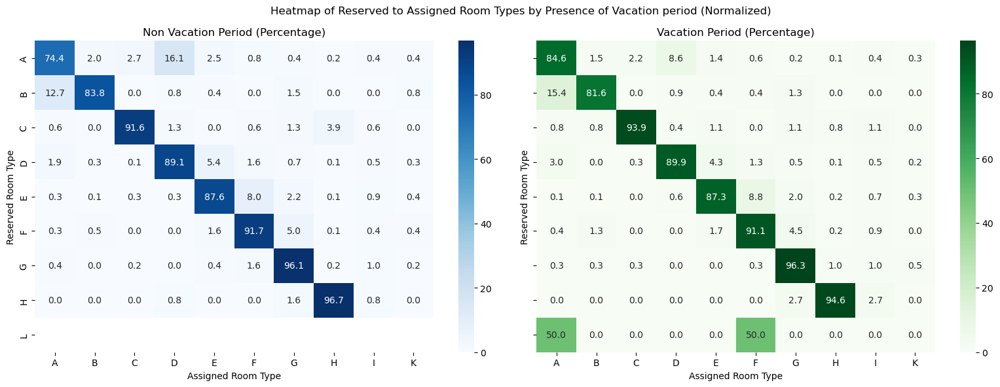

In [ ]:
# Group by reserved, assigned room types, and has_vacation to calculate the flow counts
room_flow = hotels.groupby(['reserved_room_type', 'assigned_room_type', 'has_vacation']).size().reset_index(name='count')

# Normalize the counts to percentages within each reserved_room_type and has_vacation group
room_flow['percentage'] = room_flow.groupby(['reserved_room_type', 'has_vacation'])['count'].transform(lambda x: x / x.sum() * 100)

# Separate data for bookings with and without children
room_flow_no_children = room_flow[room_flow['has_vacation'] == False].pivot(
    index='reserved_room_type', columns='assigned_room_type', values='percentage'
).fillna(0)

room_flow_with_children = room_flow[room_flow['has_vacation'] == True].pivot(
    index='reserved_room_type', columns='assigned_room_type', values='percentage'
).fillna(0)

# Plot heatmaps
fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharey=True)

sns.heatmap(room_flow_no_children, annot=True, fmt=".1f", cmap="Blues", ax=axes[0])
axes[0].set_title('Non Vacation Period (Percentage)')
axes[0].set_xlabel('Assigned Room Type')
axes[0].set_ylabel('Reserved Room Type')

sns.heatmap(room_flow_with_children, annot=True, fmt=".1f", cmap="Greens", ax=axes[1])
axes[1].set_title('Vacation Period (Percentage)')
axes[1].set_xlabel('Assigned Room Type')
axes[1].set_ylabel('Reserved Room Type')

plt.suptitle('Heatmap of Reserved to Assigned Room Types by Presence of Vacation period (Normalized)')
plt.tight_layout()
plt.show()

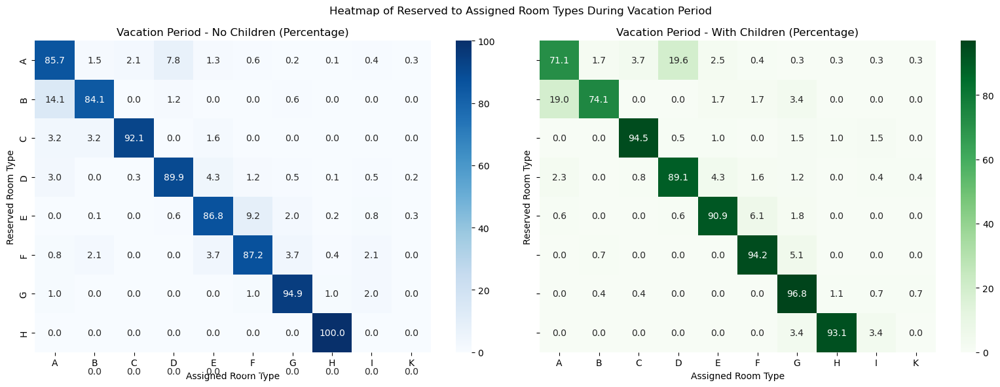

In [ ]:
# Filter data for vacation and non-vacation periods
vacation_data = hotels[hotels['has_vacation'] == True]
non_vacation_data = hotels[hotels['has_vacation'] == False]

# Group by reserved, assigned room types, and has_children for vacation period
room_flow_vacation = vacation_data.groupby(['reserved_room_type', 'assigned_room_type', 'has_children']).size().reset_index(name='count')
room_flow_vacation['percentage'] = room_flow_vacation.groupby(['reserved_room_type', 'has_children'])['count'].transform(lambda x: x / x.sum() * 100)

# Group by reserved, assigned room types, and has_children for non-vacation period
room_flow_non_vacation = non_vacation_data.groupby(['reserved_room_type', 'assigned_room_type', 'has_children']).size().reset_index(name='count')
room_flow_non_vacation['percentage'] = room_flow_non_vacation.groupby(['reserved_room_type', 'has_children'])['count'].transform(lambda x: x / x.sum() * 100)

# Create heatmaps for vacation period
room_flow_vacation_with_children = room_flow_vacation[room_flow_vacation['has_children'] == True].pivot(
    index='reserved_room_type', columns='assigned_room_type', values='percentage'
).fillna(0)

room_flow_vacation_no_children = room_flow_vacation[room_flow_vacation['has_children'] == False].pivot(
    index='reserved_room_type', columns='assigned_room_type', values='percentage'
).fillna(0)

# Plot heatmaps for vacation period
fig, axes = plt.subplots(1, 2, figsize=(16, 6), sharey=True)

sns.heatmap(room_flow_vacation_no_children, annot=True, fmt=".1f", cmap="Blues", ax=axes[0])
axes[0].set_title('Vacation Period - No Children (Percentage)')
axes[0].set_xlabel('Assigned Room Type')
axes[0].set_ylabel('Reserved Room Type')

sns.heatmap(room_flow_vacation_with_children, annot=True, fmt=".1f", cmap="Greens", ax=axes[1])
axes[1].set_title('Vacation Period - With Children (Percentage)')
axes[1].set_xlabel('Assigned Room Type')
axes[1].set_ylabel('Reserved Room Type')

plt.suptitle('Heatmap of Reserved to Assigned Room Types During Vacation Period')
plt.tight_layout()
plt.show()

**Conclusions on Room Reassignment Behavior** 

**Children and vacation periods are both associated with increased room reassignment, but the presence of children appears to be the stronger driver.**

**1. Children correlate with more reassignments**

Room reassignment occurs more frequently when children are present. While the average difference is small (18.7% without children vs. 19.7% with children), a deeper analysis by room type reveals more significant discrepancies.

For example:  
- Room A: 78.3% of guests without children received the same room type, compared to only 61.8% with children.  
- Room B: 85.8% (no children) vs. 74.8% (with children).

This indicates that guests with children are more likely to be reassigned from their reserved room type.

**2. Vacation periods amplify the effect**

The pattern becomes more pronounced during vacation periods.  
- Room A: 85.7% (no children, vacation) vs. 71.1% (with children, vacation).  
- Room B: 84.1% vs. 74.1% respectively.

This suggests that the combination of children and vacation periods contributes more strongly to room reassignment, likely due to higher demand and the need to accommodate specific family needs.

**3. Reassignment is not solely explained by overbooking**

If overbooking were the only reason, the decrease in assignment accuracy would be more uniformly distributed across room types. Instead, the largest drops are concentrated in room types A and B, which are typically standard or budget rooms. This supports the hypothesis that reassignment is influenced by internal policies or operational adjustments made to better serve families.

**4. `has_reassignment` is a valuable feature for modeling**

The feature `has_reassignment` captures important behavior patterns that are not fully explained by general occupancy trends. Including this column in the model could help improve predictions related to cancellations, satisfaction, or booking behavior.

### 1.7 Lead Time

In [ ]:
# Plot the distribution of lead time
fig = px.histogram(
    hotels,
    x='lead_time',
    nbins=50,
    title='Distribution of Lead Time',
    labels={'lead_time': 'Lead Time (Days)', 'count': 'Number of Bookings'},
)

fig.update_layout()
fig.show()

In [ ]:
# Plot lead time for reassigned vs. non-reassigned bookings
fig = px.histogram(
    hotels,
    x='lead_time',
    nbins=50,
    title='Distribution of Lead Time',
    labels={'lead_time': 'Lead Time (Days)', 'count': 'Number of Bookings'},    
    color='is_reassigned',
    color_discrete_map={True: 'red', False: 'green'}
)
fig.update_xaxes(tickvals=[False, True], ticktext=['No', 'Yes'])
fig.show()

In [ ]:
# Create a column to indicate reassignment
hotels['is_reassigned'] = hotels['reserved_room_type'] != hotels['assigned_room_type']

# Plot lead time for reassigned vs. non-reassigned bookings
fig = px.box(
    hotels,
    x='is_reassigned',
    y='lead_time',
    title='Lead Time for Reassigned vs. Non-Reassigned Bookings',
    labels={'is_reassigned': 'Reassigned', 'lead_time': 'Lead Time (Days)'},
    color='is_reassigned',
    color_discrete_map={True: 'red', False: 'green'}
)
fig.update_xaxes(tickvals=[False, True], ticktext=['No', 'Yes'])
fig.show()

In [115]:
hotels.groupby('is_reassigned')['lead_time'].agg(['mean', 'std']).reset_index()

,is_reassigned,mean,std
0,False,74.582645,82.839339
1,True,57.954668,80.142073


In [ ]:
# Calculate average lead time by reserved room type
lead_time_by_room = hotels.groupby('reserved_room_type')['lead_time'].mean().reset_index()

# Plot average lead time by reserved room type
fig = px.bar(
    lead_time_by_room,
    x='reserved_room_type',
    y='lead_time',
    title='Average Lead Time by Reserved Room Type',
    labels={'reserved_room_type': 'Reserved Room Type', 'lead_time': 'Average Lead Time (Days)'},
    color='reserved_room_type',
    color_discrete_sequence=px.colors.qualitative.Vivid
)
fig.show()

In [ ]:
# Plot lead time for vacation vs. non-vacation periods
fig = px.box(
    hotels,
    x='has_vacation',
    y='lead_time',
    title='Lead Time for Vacation vs. Non-Vacation Periods',
    labels={'has_vacation': 'Vacation Period', 'lead_time': 'Lead Time (Days)'},
    color='has_vacation',
    color_discrete_map={True: 'blue', False: 'orange'}
)
fig.update_xaxes(tickvals=[False, True], ticktext=['Non-Vacation', 'Vacation'])
fig.show()

In [84]:
hotels['lead_time_bucket'] = (
    pd.cut(
        hotels['lead_time'], 
        bins=[0, 15, 45, 100, 180, 360], 
        labels=['0-15', '15-45', '45-100', '100-180', '180-360']
    )
)

# Group by lead_time_bucket and calculate the count of bookings
lead_time_distribution = hotels['lead_time_bucket'].value_counts(normalize=True).reset_index()
lead_time_distribution.columns = ['Lead Time Bucket', 'Percentage']
lead_time_distribution['Percentage'] *= 100  # Convert to percentage

fig = px.bar(
    lead_time_distribution,
    x='Lead Time Bucket',
    y='Percentage',
    title='Distribution of Bookings by Lead Time Bucket',
    labels={'Percentage': 'Percentage of Bookings', 'Lead Time Bucket': 'Lead Time Bucket'},
    color='Lead Time Bucket',
    text='Percentage'  # Add percentage values as text
)
fig.update_traces(texttemplate='%{text:.2f}%', textposition='outside')  # Format text
fig.show()

**Conclusions on Lead Time and Reassignment Behavior**


**1. Shorter lead times are associated with more reassignments** 
The boxplot comparing reassigned vs. non-reassigned bookings shows that:
- Bookings that were **not reassigned** have a **higher median lead time** and more spread.
- **Reassigned bookings** tend to concentrate in **shorter lead times**.

This suggests that customers booking closer to check-in are more likely to be reassigned, possibly due to limited room availability or late inventory changes.

**2. Booking volume is higher in shorter lead time buckets**
The majority of bookings are made with relatively short notice:
- About **28.6%** of bookings occur with a lead time of **0–15 days**.
- The proportion of bookings steadily decreases as lead time increases.
.

**3. Lead time varies across reserved room types**  
- Guests reserving **room types A and B** tend to book further in advance, with average lead times above 80 and 100 days respectively.
- Conversely, **room types F, G, and H** have shorter average lead times.

This suggests that room category could be tied to the planning horizon, potentially due to pricing, customer segment, or seasonal availability.

**4. Vacation periods are booked earlier**
- Bookings during **vacation periods** have **consistently higher lead times** than those in non-vacation periods.
- This aligns with expectations that families or long-distance travelers plan vacations further ahead.


**Feature Enginiering: Lead Time Buckets Instead of Raw Values**

Given the skewed distribution, outliers, and the fact that operational planning benefits from broad groupings:
- It is recommended to use **lead time buckets** (e.g., 0–15, 15–45, 45–100...) instead of the raw `lead_time` variable.
- Bucketing helps reduce noise and improves interpretability of patterns for modeling.
- It also helps models learn nonlinear relationships between lead time and other outcomes (such as reassignment or cancellations).

### 1.9 Meal Preferences

In [ ]:
# Group by has_children and meal to calculate percentages
meal_analysis = hotels.groupby(['has_children', 'meal']).size().reset_index(name='count')
meal_analysis['percentage'] = meal_analysis.groupby('has_children')['count'].transform(lambda x: x / x.sum() * 100)

# Plot meal preferences
fig = px.bar(
    meal_analysis,
    x='meal',
    y='percentage',
    color='has_children',
    title='Meal Preferences by Presence of Children',
    labels={'meal': 'Meal Type', 'percentage': 'Percentage', 'has_children': 'Presence of Children'},
    barmode='group'
)
fig.show()

**Conclusion on Meal Preferences and Presence of Children**

Meal type selection appears to be a strong indicator of the presence of children. Families with children are more likely to choose meal-inclusive options, especially BB (Bed & Breakfast) and HB (Half Board), while those without children show higher relative preference for SC (Self Catering) options. This suggests that including meal in the model can help indirectly capture family composition, especially the presence of children.

### 1.10 Country

In [ ]:
# Filter top 10 countries by count
top_countries = hotels['country'].value_counts().head(10).index
country_analysis = hotels[hotels['country'].isin(top_countries)].groupby(['has_children', 'country']).size().reset_index(name='count')

# Plot country distribution
fig = px.bar(
    country_analysis,
    x='country',
    y='count',
    color='has_children',
    title='Top Countries of Origin by Presence of Children',
    labels={'country': 'Country', 'count': 'Number of Bookings', 'has_children': 'Presence of Children'},
    barmode='group'
)
fig.show()

**Conclusion on Countries of Origin and Presence of Children**

Most bookings come from guests without children, regardless of country. However, Portugal (PRT) stands out with a notably higher volume of family bookings compared to other countries. This suggests that Portuguese guests are more likely to travel with children, and country of origin may provide valuable context for identifying family-related travel patterns.

### 1.11 Market Segment

In [ ]:
# Group by has_children and market_segment to calculate percentages
market_segment_analysis = hotels.groupby(['has_children', 'market_segment']).size().reset_index(name='count')
market_segment_analysis['percentage'] = market_segment_analysis.groupby('has_children')['count'].transform(lambda x: x / x.sum() * 100)

# Plot market segment distribution
fig = px.bar(
    market_segment_analysis,
    x='market_segment',
    y='percentage',
    color='has_children',
    title='Market Segment Distribution by Presence of Children',
    labels={'market_segment': 'Market Segment', 'percentage': 'Percentage', 'has_children': 'Presence of Children'},
    barmode='group'
)
fig.show()

In [ ]:
# Plot lead time for vacation vs. non-vacation periods
fig = px.box(
    hotels,
    x='market_segment',
    y='lead_time',
    title='Lead Time for Market Segment Period',
    labels={'market_segment': 'Market Segment', 'lead_time': 'Lead Time (Days)'},
    color='has_children'
)
fig.update_xaxes()
fig.show()

**Conclusion on Market Segment and Presence of Children**

The Online TA (Travel Agency) and Direct market segments show a strong association with bookings that include children. Families are more likely to book through online platforms or directly with the hotel, while corporate and offline channels are predominantly used by guests without children. This indicates that the market_segment feature is a good proxy for identifying family-oriented bookings.

### 1.12 Deposit type

In [ ]:
# Group by has_children and deposit_type to calculate percentages
deposit_type_analysis = hotels.groupby(['has_children', 'deposit_type']).size().reset_index(name='count')
deposit_type_analysis['percentage'] = deposit_type_analysis.groupby('has_children')['count'].transform(lambda x: x / x.sum() * 100)

# Plot deposit type distribution
fig = px.bar(
    deposit_type_analysis,
    x='deposit_type',
    y='percentage',
    color='has_children',
    title='Deposit Type Distribution by Presence of Children',
    labels={'deposit_type': 'Deposit Type', 'percentage': 'Percentage', 'has_children': 'Presence of Children'},
    barmode='group'
)
fig.show()

**Conclusion**

No conclusion this featur will be removed

### 1.13 Customer Type

In [ ]:
# Group by has_children and customer_type to calculate percentages
customer_type_analysis = hotels.groupby(['has_children', 'customer_type']).size().reset_index(name='count')
customer_type_analysis['percentage'] = customer_type_analysis.groupby('has_children')['count'].transform(lambda x: x / x.sum() * 100)

# Plot customer type distribution
fig = px.bar(
    customer_type_analysis,
    x='customer_type',
    y='percentage',
    color='has_children',
    title='Customer Type Distribution by Presence of Children',
    labels={'customer_type': 'Customer Type', 'percentage': 'Percentage', 'has_children': 'Presence of Children'},
    barmode='group'
)
fig.show()

**Conclusion on Customer Type and Presence of Children**

The Transient customer type is the most common among families traveling with children, showing a clear majority compared to other types. While Transient-Party and Contract are more associated with bookings without children, they represent a smaller share overall. This highlights customer_type as a useful feature for identifying family-oriented stays, especially when combined with other behavioral indicators.

### 1.14 Parking Space Requests

In [96]:
hotels[['has_children','required_car_parking_spaces']].value_counts(normalize=True)

has_children  required_car_parking_spaces
False         none                           0.83416
              parking                        0.08508
True          none                           0.06622
              parking                        0.01454
Name: proportion, dtype: float64

In [99]:
# Calculate average parking spaces by has_children
parking_analysis = hotels.groupby(['has_children', 'required_car_parking_spaces']).size().reset_index(name='count')
parking_analysis['percentage'] = parking_analysis.groupby('has_children')['count'].transform(lambda x: x / x.sum() * 100)

# Plot parking space requests
fig = px.bar(
    parking_analysis,
    x='required_car_parking_spaces',
    y='percentage',
    color='has_children',
    title='Parking Request Distribution by Presence of Children',
    labels={'required_car_parking_spaces': 'Parking Required', 'percentage': 'Percentage', 'has_children': 'Presence of Children'},
    barmode='group'
)
fig.show()

**Conclusion on Parking Requests and Presence of Children**

Parking requests are significantly more frequent among bookings that include children. While guests without children rarely request parking, families are much more likely to do so. This suggests that families often travel by car, reinforcing the operational importance of parking availability.

Given its strong binary behavior, this variable is a clear case for feature engineering: converting required_car_parking_spaces into a binary feature such as has_required_parking_spaces can simplify modeling and enhance interpretability, especially for identifying family-related bookings

### 1.15 Booking changes

In [ ]:
# Plot the distribution of lead time
fig = px.histogram(
    hotels,
    x='booking_changes',
    title='Distribution of Booking changes',
    labels={'booking_changes': 'Booking Changes', 'count': 'Number of Bookings'},
)

fig.update_layout()
fig.show()

In [ ]:
fig = px.box(
    hotels,
    x='has_children',
    y='booking_changes',
    title='Booking Changes by Presence of Children',
    labels={'has_children': 'Presence of Children', 'booking_changes': 'Booking Changes'},
    color='has_children',
    color_discrete_map={True: 'blue', False: 'orange'}
)
fig.update_xaxes(tickvals=[False, True], ticktext=['No Children', 'With Children'])
fig.show()

In [ ]:
# Calculate average booking changes by has_children
booking_changes_analysis = hotels.groupby('has_children')['booking_changes'].mean().reset_index()

# Plot booking changes
fig = px.bar(
    booking_changes_analysis,
    x='has_children',
    y='booking_changes',
    title='Average Number of Booking Changes by Presence of Children',
    labels={'has_children': 'Presence of Children', 'booking_changes': 'Average Booking Changes'},
    color='has_children'
)
fig.show()

**Conclusion on Booking Changes and Presence of Children**

Most bookings go through zero or very few changes, but the presence of children is associated with a higher number of booking modifications. On average, bookings with children show almost twice as many changes compared to those without children.

This indicates that families may adjust travel plans more often due to their greater logistical complexity. Given its skewed distribution, the variable booking_changes is a good candidate for transformation into a binary feature like has_booking_changes, which can better capture the behavioral signal without being influenced by outliers.

### 1.16 Waiting List Days

In [112]:
hotels['days_in_waiting_list'].describe()

count    50000.0000
mean         1.5704
std         14.7903
min          0.0000
25%          0.0000
50%          0.0000
75%          0.0000
max        379.0000
Name: days_in_waiting_list, dtype: float64

In [ ]:
# Plot the distribution of waiting list
fig = px.histogram(
    hotels,
    x='days_in_waiting_list',
    title='Distribution of days in waiting list',
    labels={'days_in_waiting_list': 'Days in Waiting List', 'count': 'Number of Bookings'},
)

fig.update_layout()
fig.show()

In [120]:
hotels[hotels['days_in_waiting_list']>0]['has_children'].value_counts()

has_children
False    877
True       7
Name: count, dtype: int64

In [ ]:
# Calculate average waiting list days by has_children
waiting_list_analysis = hotels.groupby('has_children')['days_in_waiting_list'].mean().reset_index()

# Plot waiting list days
fig = px.bar(
    waiting_list_analysis,
    x='has_children',
    y='days_in_waiting_list',
    title='Average Waiting List Days by Presence of Children',
    labels={'has_children': 'Presence of Children', 'days_in_waiting_list': 'Average Waiting List Days'},
    color='has_children'
)
fig.show()

** Conclusion on Waiting List Days and Presence of Children** 

Most bookings do not spend time on a waiting list, and the few that do are heavily skewed toward lower durations. Interestingly, bookings without children have a higher average number of days on the waiting list compared to those with children.

This may indicate that reservations with children are either confirmed more quickly or prioritized differently, potentially due to operational considerations. Given the sparsity and skewed nature of the data, this feature is well-suited to a binary transformation such as has_waiting_list_days, which captures the presence or absence of waiting time more robustly.

### 1.17 Adults

In [163]:
hotels['adults'].value_counts()

adults
2    36271
1    10831
3     2675
0      194
4       29
Name: count, dtype: int64

In [165]:
hotels.groupby('adults')['has_children'].mean()

adults
0    0.458763
1    0.021051
2    0.096634
3    0.080374
4    0.034483
Name: has_children, dtype: float64

### 1.18 previous bookings cancelled and repeated guest

In [ ]:
# Plot the distribution of lead time
fig = px.histogram(
    hotels,
    x='previous_bookings_not_canceled',
    title='Distribution of previous bookings not canceled',
    labels={'previous_bookings_not_canceled': 'Previous Booking Not Cancelled', 'count': 'Number of Bookings'},
)

fig.update_layout()
fig.show()

In [ ]:
fig = px.box(
    hotels,
    x='is_repeated_guest',
    y='previous_bookings_not_canceled',
    title='Previous Cancellations by Repeated Guest',
    labels={'previous_cancellations': 'Previous Booking Cancelled', 'count': 'Number of Bookings'},
)

fig.update_layout()
fig.show()

In [ ]:
# Calculate average repeated Guest by has_children
repeated_guest = hotels.groupby(['has_children', 'is_repeated_guest']).size().reset_index(name='count')
repeated_guest['percentage'] = repeated_guest.groupby('has_children')['count'].transform(lambda x: x / x.sum() * 100)

# Plot repeated Guest 
fig = px.bar(
    repeated_guest,
    x='is_repeated_guest',
    y='percentage',
    color='has_children',
    title='Repeated Guest Distribution by Presence of Children',
    labels={'is_repeated_guest': 'Repeated Guest', 'percentage': 'Percentage', 'has_children': 'Presence of Children'},
    barmode='group'
)
fig.show()

In [100]:
# Calculate counts for repeated and non-repeated guests by has_children
odds_data = hotels.groupby(['has_children', 'is_repeated_guest']).size().reset_index(name='count')

# Pivot the data to make it easier to calculate odds
odds_pivot = odds_data.pivot(index='has_children', columns='is_repeated_guest', values='count').fillna(0)
odds_pivot.columns = ['Non-Repeated', 'Repeated']

# Calculate odds
odds_pivot['Odds'] = odds_pivot['Repeated'] / odds_pivot['Non-Repeated']

# Display the odds
print(odds_pivot)

#Calculate odds ratio
odds_ratio = odds_pivot.loc[True, 'Odds'] / odds_pivot.loc[False, 'Odds']
print(f"Odds Ratio (With Children vs Without Children): {odds_ratio}")

              Non-Repeated  Repeated      Odds
has_children                                  
False                37343      2043  0.054709
True                  3938        61  0.015490
Odds Ratio (With Children vs Without Children): 0.28313591455618875


**Conclusion on Repeated Guests and Previous Bookings Behavior**

Most guests are not repeated customers, and this is especially true among bookings with children. The odds of being a repeated guest are significantly lower for those with children, with an odds ratio of 0.32, indicating they are less likely to return compared to guests without children.

In addition, the feature previous_bookings_not_canceled is highly skewed(most values are zero), with a few high outliers. The boxplot confirms that repeated guests have a much higher average and variance in non-canceled past bookings, as expected.

This supports two modeling recommendations:

- Keep is_repeated_guest as a binary feature, as it is informative for behavior patterns and customer loyalty.

- Convert previous_bookings_not_canceled into a binary feature such as has_non_canceled_bookings to capture loyalty while avoiding distortion from extreme values.










### Correlations

In [101]:
# Select only numerical columns
numerical_columns = hotels.select_dtypes(include=['int64', 'float64', 'bool'])

# Compute the correlation matrix
correlation_matrix = numerical_columns.corr('kendall')

# Convert the correlation matrix to a long format for Plotly
correlation_long = correlation_matrix.reset_index().melt(id_vars='index')
correlation_long.columns = ['Variable 1', 'Variable 2', 'Correlation']

# Plot the correlation heatmap
fig = px.imshow(
    correlation_matrix,
    title='Correlation Heatmap of Numerical Variables',
    labels=dict(color='Correlation'),
    x=correlation_matrix.columns,
    y=correlation_matrix.columns,
    color_continuous_scale='solar'
)

fig.update_layout(
    xaxis_title='Numerical Variables',
    yaxis_title='Numerical Variables',
    width=800,
    height=800
)

fig.show()

**Modeling Implications & Feature Relationships**

1. **Low multicollinearity overall**  
   Most variables show **weak correlations**, indicating low redundancy between features — a good sign for modeling, as it suggests that each variable may contribute independently to prediction.

2. **High correlation between `stays_in_weekend_nights` and `stays_in_week_nights` with `total_nights`**  
   - These variables are linearly additive by design, so it's expected.  
   - For modeling, you may prefer to drop the individual components and keep `total_nights` if interpretability or dimensionality is a concern.

3. **`has_children` is weakly correlated with most features**  
   - This reinforces the need to use **indirect indicators** (like meal type, parking, booking changes) for family detection — as explored in your previous visual analyses.

4. **`is_reassigned` shows weak correlation with most features**  
   - Suggests that reassignment behavior is likely influenced by categorical or contextual features (like room type, booking channel) more than raw numeric ones — validating the inclusion of engineered or interaction features.

5. **`total_of_special_requests` has a weak but visible relationship with `has_children` and `total_nights`**  
   - This may reflect families making more requests (cribs, extra beds, etc.), and staying longer.

6. **Behavioral features cluster together**  
   - `booking_changes`, `previous_bookings_not_canceled`, and `is_repeated_guest` show some weak positive correlations among themselves, which aligns with expected behavioral patterns (repeat guests with stable history tend to change or adjust bookings more).

## Part II - Modeling

The objective of this stage is to build a predictive model capable of identifying whether a hotel booking includes children or babies. This classification will support downstream decision-making, such as reassignment logic, marketing segmentation, and operational planning.

To enhance the quality of the input data, we applied a set of custom transformations implemented in our `pipeline.py` and `transformers.py` modules. These transformations include domain-driven feature engineering, encoding strategies, and behavior-based indicators derived from booking patterns.

We then evaluated three tree-based classifiers commonly used for tabular data:

- LightGBM

- XGBoost

- CatBoost

Since we are classifying the presence of children, our primary concern is minimizing **false positives** (i.e., predicting the presence of children when there are none). Therefore, we prioritized precision as the main evaluation metric. However, we also report F1-score, recall, and other relevant metrics to provide a more comprehensive view of model performance.

### 2.1 Data Import

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    classification_report, 
    roc_auc_score, 
    f1_score,
)
from pipeline import create_pipeline

In [2]:
hotels = pd.read_csv('data/hotels.csv')
hotels.head()


,hotel,lead_time,stays_in_weekend_nights,stays_in_week_nights,adults,children,meal,country,market_segment,distribution_channel,...,reserved_room_type,assigned_room_type,booking_changes,deposit_type,days_in_waiting_list,customer_type,average_daily_rate,required_car_parking_spaces,total_of_special_requests,arrival_date
0,City_Hotel,217,1,3,2,none,BB,DEU,Offline_TA/TO,TA/TO,...,A,A,0,No_Deposit,0,Transient-Party,80.75,none,1,2016-09-01
1,City_Hotel,2,0,1,2,none,BB,PRT,Direct,Direct,...,D,K,0,No_Deposit,0,Transient,170.00,none,3,2017-08-25
2,Resort_Hotel,95,2,5,2,none,BB,GBR,Online_TA,TA/TO,...,A,A,2,No_Deposit,0,Transient,8.00,none,2,2016-11-19
3,Resort_Hotel,143,2,6,2,none,HB,ROU,Online_TA,TA/TO,...,A,A,0,No_Deposit,0,Transient,81.00,none,1,2016-04-26
4,Resort_Hotel,136,1,4,2,none,HB,PRT,Direct,Direct,...,F,F,0,No_Deposit,0,Transient,157.60,none,4,2016-12-28


In [ ]:
hotels = hotels.drop_duplicates().dropna(axis=0)
hotels["has_children"] = (hotels['children'].str.lower() != "none").astype(int)

### 2.1 Data Split

In [4]:
# Split the data
X = hotels.drop(columns=['has_children'])
y = (hotels['has_children']).astype(int)  # Target: has children or not
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42, stratify=y)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((30168, 23), (12930, 23), (30168,), (12930,))

### 2.3 Data Transform

In [5]:
pipeline = create_pipeline()

# Fit the pipeline and train models
pipeline.fit(X_train, y_train)
# Transform the data using the pipeline
X_train_transformed = pipeline.transform(X_train)
X_test_transformed = pipeline.transform(X_test)

[ColumnTransformer]  (1 of 2) Processing CategoricalOrdinalEncoder, total=   0.4s
[ColumnTransformer] ..... (2 of 2) Processing remainder, total=   0.0s


In [6]:
X_train_transformed.columns

Index(['hotel', 'children', 'meal', 'country', 'market_segment',
       'distribution_channel', 'reserved_room_type', 'assigned_room_type',
       'deposit_type', 'customer_type', 'required_car_parking_spaces',
       'lead_time_bucket', 'average_daily_rate', 'lead_time',
       'stays_in_weekend_nights', 'stays_in_week_nights', 'adults',
       'is_repeated_guest', 'previous_cancellations',
       'previous_bookings_not_canceled', 'booking_changes',
       'days_in_waiting_list', 'total_of_special_requests', 'arrival_date',
       'arrival_year', 'arrival_month', 'arrival_day', 'is_weekend',
       'is_vacation', 'has_previous_cancellations', 'has_booking_changes',
       'has_total_of_special_requests', 'has_days_in_waiting_list',
       'has_required_car_parking_spaces', 'has_room_reassignment',
       'total_nights', 'total_money'],
      dtype='object')

In [7]:
features_model = [
    'hotel',
    'meal',
    'country',
    'market_segment',
    'assigned_room_type',
    'lead_time_bucket',
    'customer_type',
    'adults',
    'average_daily_rate',
    'stays_in_weekend_nights',
    'arrival_month',
    'is_repeated_guest',
    'is_weekend',
    'is_vacation',
    'has_total_of_special_requests', 
    'has_days_in_waiting_list',
    'has_required_car_parking_spaces', 
    'has_booking_changes',
    'has_room_reassignment',
    'has_previous_cancellations',
    'total_nights', 
    'total_money'
]

In [8]:
cat_features = X_train_transformed[features_model].select_dtypes(include=['category']).columns.values

### 2.4 Train Model

In [108]:
##droping NA's because cat boost does not support NA's
idxs_na = X_test_transformed[X_test_transformed['country'].isna()].index.values
print(X_test_transformed.shape, y_test.shape)
X_test_transformed = X_test_transformed.drop(idxs_na)
y_test = y_test.drop(idxs_na)
print(X_test_transformed.shape, y_test.shape)

(12919, 37) (12919,)
(12919, 37) (12919,)


#### LGBM

In [109]:
from lightgbm import LGBMClassifier

lgb_params = {
    "class_weight":"balanced",
    "n_estimators": 500,
    "learning_rate": 0.1,
    "max_depth": 30,
    "num_leaves": 40,
    "subsample": 0.8,
    "colsample_bytree": 0.95,
    "random_state": 42,
}

# Train LightGBM
lgbm = LGBMClassifier(**lgb_params, categorical_feature=cat_features)
# Train the model
lgbm.fit(X_train_transformed[features_model], y_train)

# predict labels
y_pred_lgbm = lgbm.predict(X_test_transformed[features_model])
# Get predicted probabilities
y_pred_proba_lgbm = lgbm.predict_proba(X_test_transformed[features_model])[:, 1]

# Evaluate the model
print("LightGBM:\n", classification_report(y_test, y_pred_lgbm))
print("ROC AUC:", roc_auc_score(y_test, y_pred_proba_lgbm))
print("F1 Score:", f1_score(y_test, y_pred_lgbm))

/home/yan-cunha/anaconda3/lib/python3.9/site-packages/lightgbm/basic.py:2137: UserWarning:

categorical_feature keyword has been found in `params` and will be ignored.
Please use categorical_feature argument of the Dataset constructor to pass this parameter.

/home/yan-cunha/anaconda3/lib/python3.9/site-packages/lightgbm/basic.py:2159: UserWarning:

categorical_feature in param dict is overridden.



[LightGBM] [Warning] categorical_feature is set=hotel,meal,country,market_segment,assigned_room_type,lead_time_bucket,customer_type, categorical_column=0,1,2,3,4,5,6 will be ignored. Current value: categorical_feature=hotel,meal,country,market_segment,assigned_room_type,lead_time_bucket,customer_type
[LightGBM] [Info] Number of positive: 2791, number of negative: 27377
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004405 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 715
[LightGBM] [Info] Number of data points in the train set: 30168, number of used features: 22
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Info] Start training from score 0.000000
LightGBM:
               precision    recall  f1-score   support

           0       0.96      0.94      0.95     11724
           1       0.53 

#### XGBoost

In [110]:
from xgboost import XGBClassifier

xgb_params = {
    "n_estimators": 500,
    "learning_rate": 0.05,
    "max_depth": 12,
    "gamma": 0.05, 
    "scale_pos_weight": 2,  
    "min_child_weight": 1, 
    "subsample": 0.8,
    "colsample_bytree": 0.95,
    "random_state": 42,
}

# Train XGBoost
xgb = XGBClassifier(eval_metric='logloss', enable_categorical=True, **xgb_params)
xgb.fit(X_train_transformed[features_model], y_train)
# predict labels
y_pred_xgb = xgb.predict(X_test_transformed[features_model])
# Get predicted probabilities
y_pred_proba_xgb = xgb.predict_proba(X_test_transformed[features_model])[:, 1]

# Evaluate the model
print("XGBoost:\n", classification_report(y_test, y_pred_xgb))
print("ROC AUC:", roc_auc_score(y_test, y_pred_proba_xgb))
print("F1 Score:", f1_score(y_test, y_pred_xgb))

XGBoost:
               precision    recall  f1-score   support

           0       0.95      0.98      0.97     11724
           1       0.75      0.50      0.60      1195

    accuracy                           0.94     12919
   macro avg       0.85      0.74      0.78     12919
weighted avg       0.93      0.94      0.93     12919

ROC AUC: 0.9028542459839917
F1 Score: 0.5973763874873865


#### CatBoost

In [111]:
from catboost import CatBoostClassifier

catb_params = {
    "n_estimators": 500,
    "learning_rate": 0.05,
    "max_depth": 12,
    "scale_pos_weight": 1,  
    "subsample": 0.95,
    "random_state": 42,
}

# Train CatBoost
catboost = CatBoostClassifier(cat_features=cat_features, verbose=0, **catb_params)
catboost.fit(X_train_transformed[features_model], y_train)

# Predict in test set
y_pred_catboost = catboost.predict(X_test_transformed[features_model])

y_pred_proba_catb = catboost.predict_proba(X_test_transformed[features_model])[:, 1]
# Evaluate the model
print("CatBoost:\n", classification_report(y_test, y_pred_catboost))
print("ROC AUC:", roc_auc_score(y_test, y_pred_proba_catb))
print("F1 Score:", f1_score(y_test, y_pred_catboost))

CatBoost:
               precision    recall  f1-score   support

           0       0.95      0.99      0.97     11724
           1       0.81      0.45      0.58      1195

    accuracy                           0.94     12919
   macro avg       0.88      0.72      0.77     12919
weighted avg       0.93      0.94      0.93     12919

ROC AUC: 0.9082049267032972
F1 Score: 0.577729962345347


### 2.5 Evaluate & Compare models


In [104]:
# Define metrics for each model
metrics = {
    "Model": ["LightGBM", "XGBoost", "CatBoost"],
    "Precision (class 1)": [0.53, 0.75, 0.81],
    "Recall (class 1)": [0.64, 0.50, 0.45],
    "F1 Score (class 1)": [0.5788, 0.5978, 0.5777],
    "ROC AUC": [0.8951, 0.9030, 0.9082]
}

# Create DataFrame
df_metrics = pd.DataFrame(metrics)

print(df_metrics)
# Create plotly bar chart
fig = go.Figure()

for metric in ["Precision (class 1)", "Recall (class 1)", "F1 Score (class 1)", "ROC AUC"]:
    fig.add_trace(go.Bar(
        x=df_metrics["Model"],
        y=df_metrics[metric],
        name=metric
    ))

fig.update_layout(
    title="Comparison of Model Metrics",
    xaxis_title="Model",
    yaxis_title="Score",
    yaxis=dict(range=[0, 1]),
    barmode='group',
    template="plotly_white",
    legend_title="Metric",
    height=500,
    width=800
)

fig.show()

      Model  Precision (class 1)  Recall (class 1)  F1 Score (class 1)  \
0  LightGBM                 0.53              0.64              0.5788   
1   XGBoost                 0.75              0.50              0.5978   
2  CatBoost                 0.81              0.45              0.5777   

   ROC AUC  
0   0.8951  
1   0.9030  
2   0.9082  


In [114]:
import plotly.graph_objects as go
from sklearn.metrics import roc_curve, auc

# Compute ROC curve and AUC for each model
fpr_lgbm, tpr_lgbm, _ = roc_curve(y_test, y_pred_proba_lgbm)
fpr_xgb, tpr_xgb, _ = roc_curve(y_test, y_pred_proba_xgb)
fpr_cat, tpr_cat, _ = roc_curve(y_test, y_pred_proba_catb)

auc_lgbm = auc(fpr_lgbm, tpr_lgbm)
auc_xgb = auc(fpr_xgb, tpr_xgb)
auc_cat = auc(fpr_cat, tpr_cat)

# Create the plotly figure
fig = go.Figure()

fig.add_trace(go.Scatter(x=fpr_lgbm, y=tpr_lgbm, mode='lines', name=f'LightGBM (AUC = {auc_lgbm:.3f})'))
fig.add_trace(go.Scatter(x=fpr_xgb, y=tpr_xgb, mode='lines', name=f'XGBoost (AUC = {auc_xgb:.3f})'))
fig.add_trace(go.Scatter(x=fpr_cat, y=tpr_cat, mode='lines', name=f'CatBoost (AUC = {auc_cat:.3f})'))
fig.add_trace(go.Scatter(x=[0, 1], y=[0, 1], mode='lines', name='Random', line=dict(dash='dash')))

fig.update_layout(
    title='ROC Curve Comparison',
    xaxis_title='False Positive Rate',
    yaxis_title='True Positive Rate',
    template='plotly_white',
    width=800,
    height=500,
    legend_title='Model',
    showlegend=True
)

fig.show()


**Conclusion on Model Performance**

All three models—LightGBM, XGBoost, and CatBoost—performed well in terms of overall accuracy and ROC AUC, demonstrating solid ability to differentiate bookings with and without children. However, since the business objective prioritizes **precision for the positive class (presence of children)** to minimize false positives, special attention is given to that metric.

- **CatBoost** achieved the **highest precision for class 1 (0.81)**, indicating stronger reliability when predicting that a booking includes children. This aligns well with the project’s focus on avoiding incorrect assumptions about child presence.
- **XGBoost** showed a **more balanced trade-off between precision and recall**, leading to the **highest F1-score (0.60)** and the best overall **ROC AUC (0.90)**. It outperformed others in overall robustness.
- **LightGBM** had the **lowest precision (0.53)** for class 1 and the lowest F1-score, although its recall was relatively higher (0.64), suggesting it was more sensitive but also more prone to false positives.

**Final Consideration**

Given the project's emphasis on **precision for child detection**, **CatBoost** appears to be the most suitable model despite its lower recall. However, **XGBoost** remains a strong alternative if a more balanced precision-recall trade-off is needed. Further tuning or ensemble strategies could also help refine this performance further.

### 2.6 SHAP

In [11]:
import shap

#### LGBM

/home/yan-cunha/anaconda3/lib/python3.9/site-packages/shap/explainers/_tree.py:583: UserWarning: LightGBM binary classifier with TreeExplainer shap values output has changed to a list of ndarray
  warnings.warn(


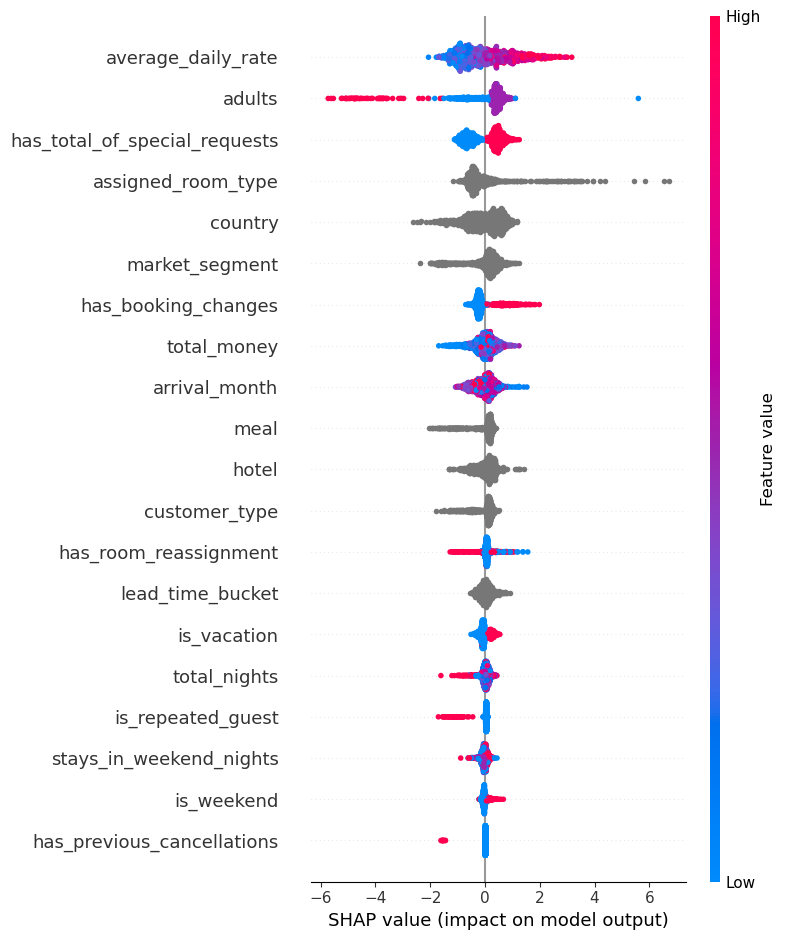

In [30]:
##sample for fast shap values calculation
idsx_sample = X_test_transformed[features_model].sample(n=1000, random_state=42).index

# Initialize the SHAP explainer
explainer = shap.TreeExplainer(lgbm)

# Calculate SHAP values for the test set
shap_values = explainer.shap_values(X_test_transformed.loc[idsx_sample, features_model])

shap.summary_plot(shap_values, X_test_transformed.loc[idsx_sample, features_model])

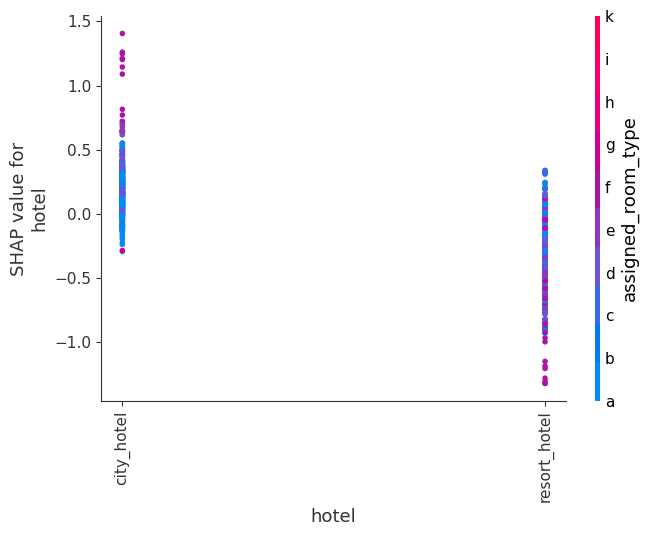

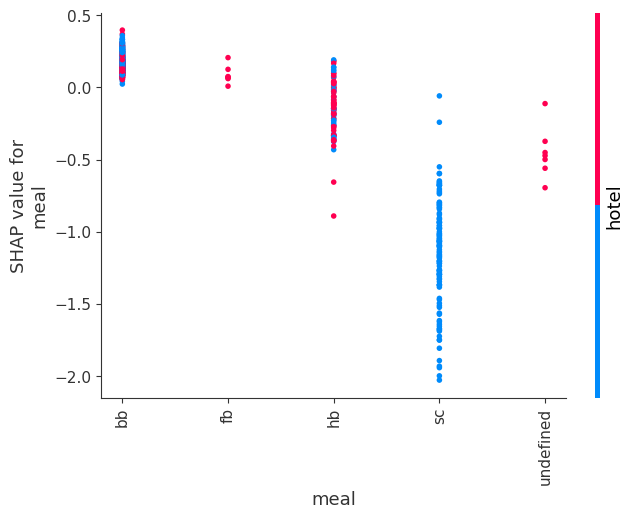

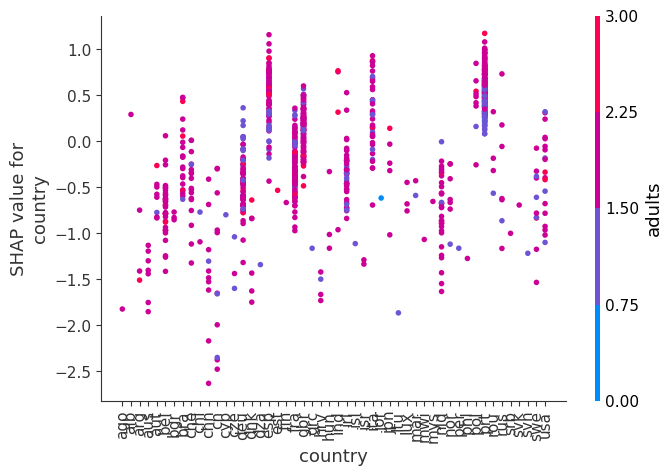

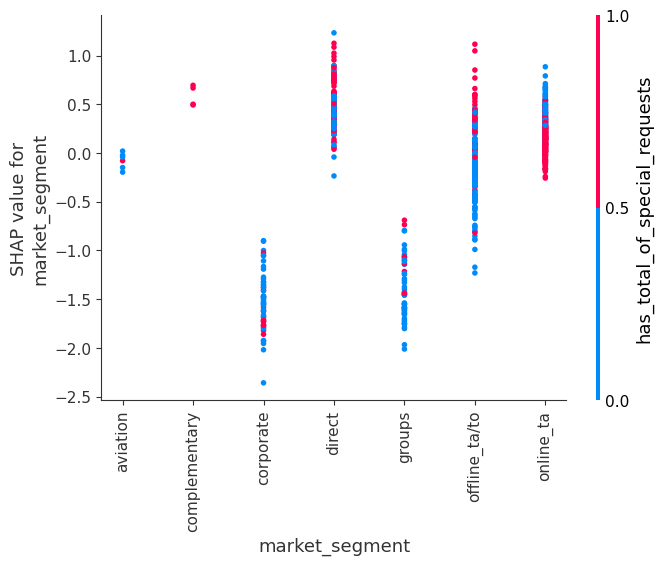

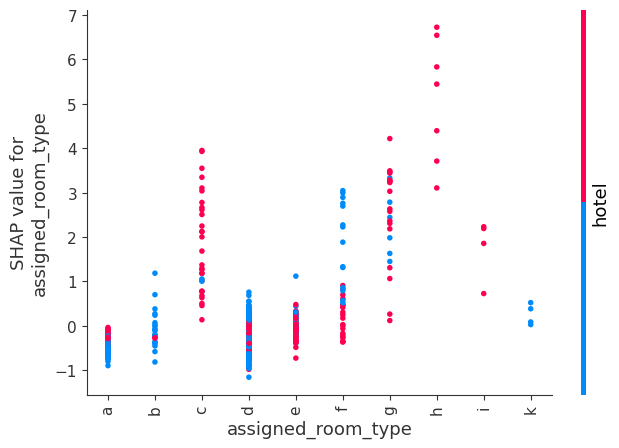

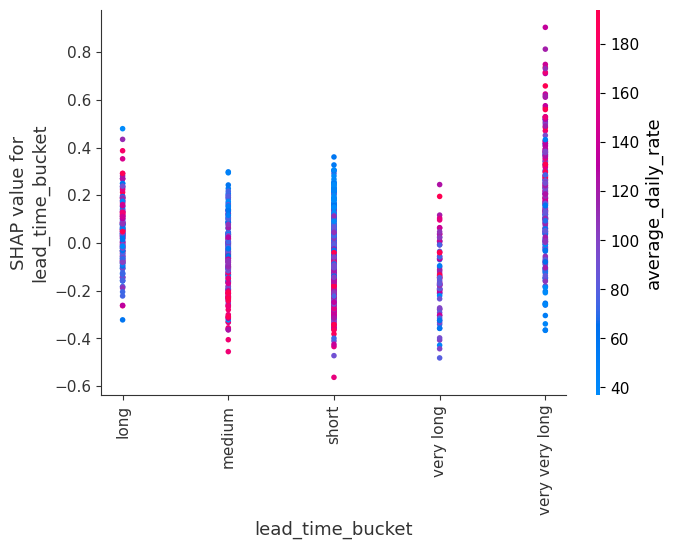

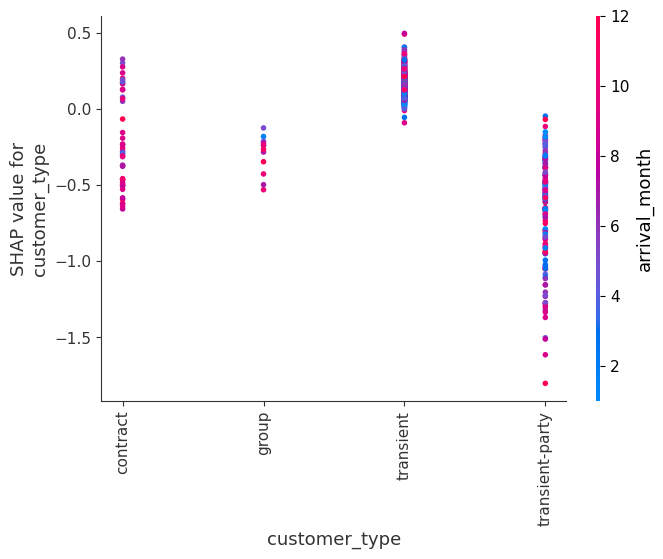

In [34]:
for name in cat_features:
    shap.dependence_plot(name, shap_values, X_test_transformed.loc[idsx_sample, features_model])

#### XGBoost

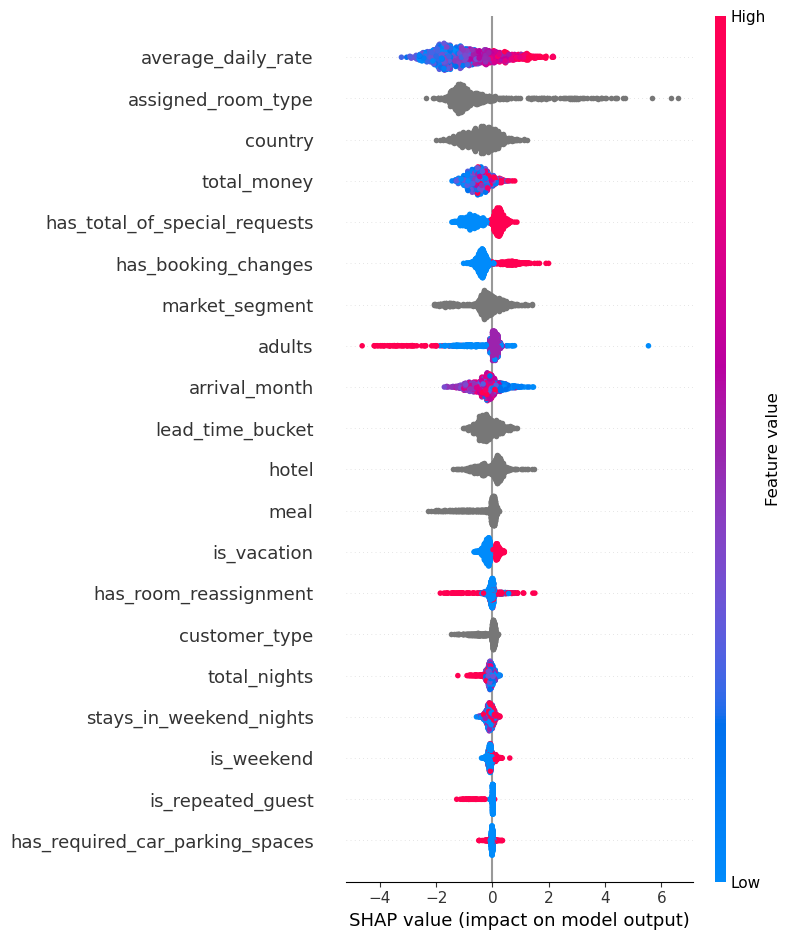

In [28]:
##sample for fast shap values calculation
idsx_sample = X_test_transformed[features_model].sample(n=1000, random_state=42).index

# Initialize the SHAP explainer
explainer = shap.TreeExplainer(xgb)

# Calculate SHAP values for the test set
shap_values = explainer.shap_values(X_test_transformed.loc[idsx_sample, features_model])

shap.summary_plot(shap_values, X_test_transformed.loc[idsx_sample, features_model])

#### CatBoost

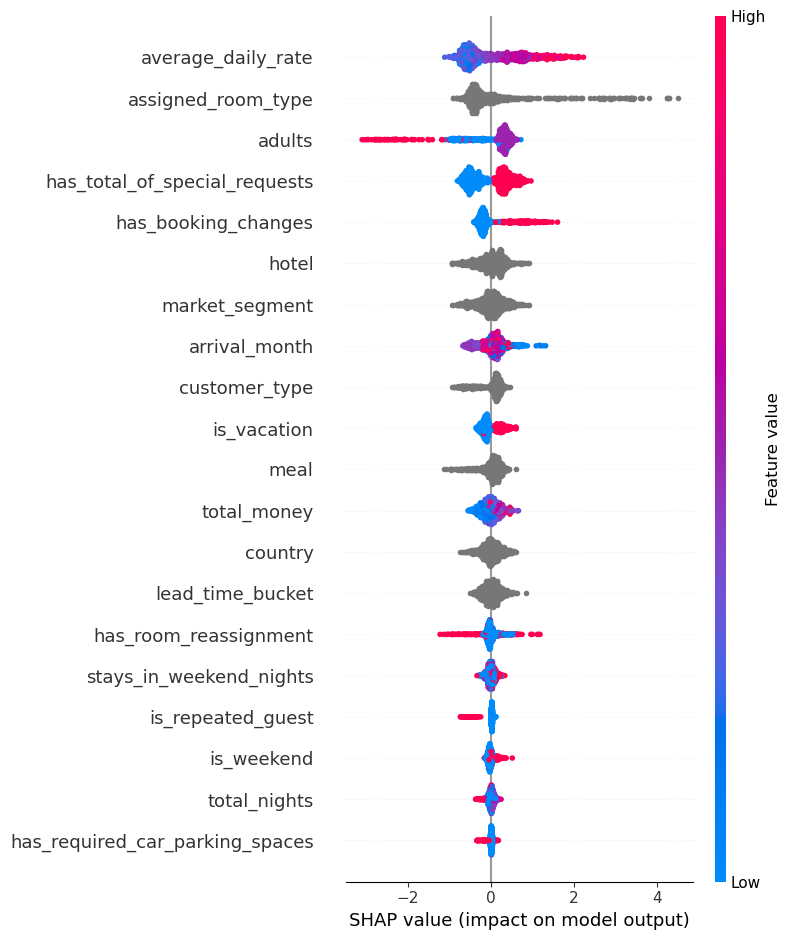

In [38]:
##sample for fast shap values calculation
idsx_sample = X_test_transformed[features_model].sample(n=1000, random_state=42).index

# Initialize the SHAP explainer
explainer = shap.TreeExplainer(catboost)

# Calculate SHAP values for the test set
shap_values = explainer.shap_values(X_test_transformed.loc[idsx_sample, features_model])

shap.summary_plot(shap_values, X_test_transformed.loc[idsx_sample, features_model])

**Conclusion from SHAP Summary Plot (Feature Importance)**

This SHAP summary plot illustrates the impact of each feature on the model’s output for predicting the presence of children in hotel bookings. The analysis confirms the relevance of the engineered features and provides strong support for the modeling choices.

Key Insights:
-  average_daily_rate is the most influential feature, with higher prices generally increasing the likelihood of child presence. This could be associated with family-oriented room packages or vacation planning behavior.

- assigned_room_type and adults follow closely, suggesting that room allocation and group size are key indicators of family stays.

- Engineered binary features like has_total_of_special_requests, has_booking_changes, and has_required_car_parking_spaces are among the top contributors, validating their inclusion and confirming that behavioral and operational markers are valuable signals for child detection.

- Features such as market_segment, meal, and customer_type also play meaningful roles, reinforcing earlier exploratory findings that families are more common in certain channels and booking profiles.

- Calendar variables like arrival_month and vacation markers (is_vacation, is_weekend) are less dominant but still carry useful context.

## Part III - Results & Conclusions

#
Part III - Summary for Non-Technical Stakeholders
1. Key Findings from Exploratory Analysis (Part I)
- Bookings that include children are associated with specific behavioral patterns: they are more likely
to involve parking requests, booking changes, and meal packages like Bed & Breakfast.
- Families tend to book further in advance during vacation periods, and are more likely to be
reassigned from the originally reserved room.
- Certain features like room type, customer type, and market segment show distinct patterns when
children are present.
- Guests from Portugal are more likely to book with children compared to other countries.
2. Explanation of Features Added (Part II)
We engineered new features to better capture behavior and improve prediction of bookings with
children:
- has_total_of_special_requests: captures if guests made any special requests.
- has_booking_changes: indicates whether a booking was modified after reservation.
- has_required_car_parking_spaces: flags whether parking was requested.
- is_vacation: marks bookings made during vacation periods.
- lead_time_bucket: groups lead time into meaningful intervals for better interpretation.
- has_room_reassignment: reflects if guests were assigned a different room than originally reserved.
These features help the model understand behaviors that are typical of families, even if the
presence of children is not directly declared.
3. Model Performance Summary
Three machine learning models were tested: LightGBM, XGBoost, and CatBoost. All performed well,
but with different strengths:
- CatBoost had the highest precision (81%) for identifying bookings with children, making it the best
choice when false positives must be minimized.
- XGBoost showed the best balance between precision and recall, achieving the highest overall F1
score.
- LightGBM performed adequately but was less precise than the others.
Overall accuracy was above 91% for all models, and we confirmed our most important features
using SHAP (a model interpretability tool).#